<a href="https://colab.research.google.com/github/ankanghosh/object-detection-with-tensorflow-hub/blob/main/Object_Detection_Using_TensorFlow_Hub.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Object Detection using TensorFlow Hub

## Introduction

The goal of this tutorial is to demonstrate object detection on images using TensorFlow and pre-trained models from [TensorFlow Hub](https://www.tensorflow.org/hub). We will also explore keypoint detection and instance segmentation. For this purpose, we will process both sample images and user-uploaded photos, showcasing multiple state-of-the-art computer vision techniques. This tutorial is based on TensorFlow’s [original tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection) on object detection using TensorFlow Hub, with modifications and additional insights.

## Setup

Import necessary libraries for computer vision, visualization, UI components, and warning suppression.

In [1]:
# Import necessary libraries for computer vision, visualization, UI components, and warning suppression.
import absl.logging
import tensorflow_hub as hub
import numpy as np
import tensorflow as tf
import cv2
import random
import matplotlib.pyplot as plt
from six.moves.urllib.request import urlopen
import PIL
from PIL import Image
import io
import ipywidgets as widgets
from IPython.display import display


Set Abseil logging verbosity to `ERROR` to suppress warnings and only show critical errors.

In [2]:
# Set Abseil logging verbosity to "ERROR" to suppress warnings and only show critical errors.
absl.logging.set_verbosity(absl.logging.ERROR)

## Load detection models

We will use detection models trained on the [COCO 2017](https://cocodataset.org/#home) dataset for this work. [Here](https://www.kaggle.com/datasets/awsaf49/coco-2017-dataset) is the Kaggle URL for the dataset. Start by creating a dictionary mapping the COCO 2017 dataset class IDs to their names. This allows us to display human-readable labels for detected objects.

**NOTE:** We will use object detection, keypoint detection, and instance segmentation models for this work. While instance segmentation falls under the broader category of object detection, keypoint detection is a distinct task. However, all of the three are generally considered part of the object detection ecosystem. The models that facilitate object detection, keypoint detection, and instance segmentation are also referred to as detection models.

In [3]:
# Dictionary mapping COCO dataset class IDs to their names.
# This allows us to display human-readable labels for detected objects.
COCO_LABELS = {
    1: "person", 2: "bicycle", 3: "car", 4: "motorcycle", 5: "airplane", 6: "bus",
    7: "train", 8: "truck", 9: "boat", 10: "traffic light", 11: "fire hydrant",
    13: "stop sign", 14: "parking meter", 15: "bench", 16: "bird", 17: "cat",
    18: "dog", 19: "horse", 20: "sheep", 21: "cow", 22: "elephant", 23: "bear",
    24: "zebra", 25: "giraffe", 27: "backpack", 28: "umbrella", 31: "handbag",
    32: "tie", 33: "suitcase", 34: "frisbee", 35: "skis", 36: "snowboard",
    37: "sports ball", 38: "kite", 39: "baseball bat", 40: "baseball glove",
    41: "skateboard", 42: "surfboard", 43: "tennis racket", 44: "bottle",
    46: "wine glass", 47: "cup", 48: "fork", 49: "knife", 50: "spoon",
    51: "bowl", 52: "banana", 53: "apple", 54: "sandwich", 55: "orange",
    56: "broccoli", 57: "carrot", 58: "hot dog", 59: "pizza", 60: "donut",
    61: "cake", 62: "chair", 63: "couch", 64: "potted plant", 65: "bed",
    67: "dining table", 70: "toilet", 72: "TV", 73: "laptop", 74: "mouse",
    75: "remote", 76: "keyboard", 77: "cell phone", 78: "microwave",
    79: "oven", 80: "toaster", 81: "sink", 82: "refrigerator", 84: "book",
    85: "clock", 86: "vase", 87: "scissors", 88: "teddy bear", 89: "hair drier",
    90: "toothbrush"
}

### Object detection

Object detection is a computer vision technique that locates and identifies objects in images or video streams. Unlike simple classification that tells you what's in an image, object detection tells you what objects are present and where they are located using bounding boxes.

To begin with, we will load pre-trained, saved object detection models from TensorFlow Hub. Saved models can be loaded from a specified handle, where the handle is a filesystem path - a valid [tfhub.dev](https://tfhub.dev) model URL. This path / URL is often referred to as the model handle. Learn [more](https://www.tensorflow.org/hub/tf2_saved_model). [Here](https://www.kaggle.com/models?id=220,152,130,183,264,46,211,299,276&tfhub-redirect=true) is the collection of TensorFlow 2 object detection models trained on the COCO 2017 dataset. Additionally, find all object detection models currently available on [tfhub.dev](https://tfhub.dev) [here](https://www.kaggle.com/models?query=image-object-detection). The list includes keypoint detection and instance segmentation models.

Go ahead and load a [Faster R-CNN](https://arxiv.org/abs/1506.01497) model from TensorFlow Hub to perform object detection. Faster R-CNN (Region-based Convolutional Neural Network) is a prominent deep learning model for object detection tasks that improves upon [Fast R-CNN](https://arxiv.org/abs/1504.08083) by incorporating a Region Proposal Network (RPN) for efficient and accurate object localization within images with CNNs. Here, we will use the `Faster R-CNN Inception ResNet V2 1024x1024` (see references [1](https://arxiv.org/abs/1506.01497) and [2](https://arxiv.org/abs/1602.07261)) model, which combines the speed of Faster R-CNN with the high accuracy of the [`Inception-ResNet-v2`](https://arxiv.org/abs/1602.07261) backbone, enabling robust detection of objects in high-resolution images.

In [4]:
# Load the Faster R-CNN model from TensorFlow Hub.
FASTER_RCNN_MODEL_HANDLE = "https://tfhub.dev/tensorflow/faster_rcnn/inception_resnet_v2_1024x1024/1"
print(f"Loading Faster R-CNN model from: {FASTER_RCNN_MODEL_HANDLE}")
faster_rcnn_model = hub.load(FASTER_RCNN_MODEL_HANDLE)
print("Faster R-CNN model loaded.")

Loading Faster R-CNN model from: https://tfhub.dev/tensorflow/faster_rcnn/inception_resnet_v2_1024x1024/1
Faster R-CNN model loaded.


### Keypoint detection

Keypoints are specific, predefined locations on an object (e.g., joints on a human body) that help identify meaningful features in an image. Keypoint detection is a computer vision task that automatically identifies these crucial points to understand an object’s structure and movement. Keypoints are commonly used in tasks like human pose estimation and fitness tracking to detect body joints and facial landmarks. Go ahead and add the list of [keypoint names](https://viso.ai/computer-vision/coco-dataset/) for the COCO 2017 keypoint detection task.

In [5]:
# List of keypoint names for the COCO 2017 keypoint detection task.
# These help in identifying different body joints and facial features for human pose estimation.
COCO2017_KEYPOINT_NAMES = [
    "nose", "left_eye", "right_eye", "left_ear", "right_ear",
    "left_shoulder", "right_shoulder", "left_elbow", "right_elbow",
    "left_wrist", "right_wrist", "left_hip", "right_hip",
    "left_knee", "right_knee", "left_ankle", "right_ankle"
]

Define pairs of keypoints that should be connected to form the human skeleton. This creates the visual representation of the structure of a human body. The keypoints can be found in TensorFlow's [tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection) on object detection using TensorFlow Hub.

In [6]:
# Define pairs of keypoints that should be connected to form the human skeleton.
# This creates the visual representation of the structure of a human body.
COCO2017_HUMAN_POSE_KEYPOINTS = [
    (0, 1), (0, 2), (1, 3), (2, 4),  # Head.
    (0, 5), (0, 6), (5, 7), (7, 9), (6, 8), (8, 10),  # Upper Body.
    (5, 6), (5, 11), (6, 12), (11, 12),  # Torso.
    (11, 13), (13, 15), (12, 14), (14, 16)  # Lower Body.
]

Load a [CenterNet](https://arxiv.org/abs/1904.07850) model for human pose estimation (keypoint detection). In this tutorial, we will be using the [`CenterNet HourGlass104 Keypoints 512x512`](https://arxiv.org/abs/1904.07850) model. `CenterNet HourGlass104 Keypoints 512x512` is a keypoint detection model based on the [CenterNet framework](https://arxiv.org/abs/1904.07850) - an object detection framework that interprets objects as points and utilizes keypoint estimation to identify object centers and related attributes. It employs a fully convolutional architecture with an [`HourGlass-104`](https://arxiv.org/abs/1603.06937) backbone to detect objects without relying on region proposals, enabling fast and accurate bounding box predictions. The HourGlass-104 backbone is a deep CNN designed to capture multi-scale features, enhancing the model’s ability to detect objects of varying sizes and shapes. The integration of CenterNet with the HourGlass-104 backbone results in a robust framework capable of precise object detection and localization.

In [7]:
# Load a CenterNet model for human pose estimation (keypoint detection).
CENTERNET_MODEL_HANDLE = "https://tfhub.dev/tensorflow/centernet/hourglass_512x512_kpts/1"
print(f"Loading CenterNet model from: {CENTERNET_MODEL_HANDLE}")
centernet_model = hub.load(CENTERNET_MODEL_HANDLE)
print("CenterNet model loaded.")

Loading CenterNet model from: https://tfhub.dev/tensorflow/centernet/hourglass_512x512_kpts/1
CenterNet model loaded.


### Instance segmentation

Among the object detection models available in TensorFlow’s [object detection tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection), `Mask R-CNN Inception ResNet V2 1024x1024` supports instance segmentation. The current model in use - `Faster R-CNN Inception ResNet V2 1024x1024`, does not support instance segmentation.

Instance segmentation is a type of computer vision and object detection technique that not only detects objects in an image but also outlines their exact shape. Regular object detection identifies objects by drawing bounding boxes around them, but it does not capture their precise boundaries. Instance segmentation goes a step further by labeling each pixel belonging to an individual object, even when multiple objects of the same category overlap. This helps in understanding both what the objects are and exactly where they are in the image.

Example: If an image contains three cats, regular object detection will place three bounding boxes around them, while instance segmentation will generate three separate masks, one for each cat, capturing their exact shape.

Load a [Mask R-CNN](https://arxiv.org/abs/1703.06870) model for instance segmentation. Mask R-CNN is a powerful deep learning model for instance segmentation that extends Faster R-CNN by adding a parallel branch for pixel-level mask prediction, enabling precise object segmentation alongside bounding box detection. It builds upon the RPN from Faster R-CNN while incorporating a [Fully Convolutional Network (FCN)](https://arxiv.org/abs/1411.4038) to generate high-quality segmentation masks for each detected object. In this work, we will use the `Mask R-CNN Inception ResNet V2 1024x1024` model, which leverages the [`Inception-ResNet-v2`](https://arxiv.org/abs/1602.07261) backbone to achieve high accuracy while maintaining efficient processing. This combination enhances the model’s ability to accurately segment objects in high-resolution images, making it highly effective for applications requiring fine-grained object localization.

In [8]:
# Load a Mask R-CNN model for instance segmentation.
MASK_RCNN_MODEL_HANDLE = "https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1"
print(f"Loading Mask R-CNN model from: {MASK_RCNN_MODEL_HANDLE}")
mask_rcnn_model = hub.load(MASK_RCNN_MODEL_HANDLE)
print("Mask R-CNN model loaded.")

Loading Mask R-CNN model from: https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1
Mask R-CNN model loaded.


## Visualization

Go ahead and build the functionality to visualize the detection results. To begin with, define a function called `run_object_detection()` to perform inference on an image using an object detection model. The function ensures that the image is in the correct format, converts it to a TensorFlow tensor, and adds a batch dimension. After running the model, it converts the output tensors to NumPy arrays for easier handling and returns a dictionary containing the detection results, such as bounding boxes, class labels, and confidence scores.

**Note:** Bounding boxes are rectangular regions around detected objects in an image. Confidence scores indicate the model’s certainty about each detection.

In [9]:
# Define a function to perform inference on an image using an object detection model.
def run_object_detection(image_np, model):
    # Ensure that the image is in correct format (NumPy array with "uint8" type).
    if not isinstance(image_np, np.ndarray) or image_np.dtype != np.uint8:
        image_np = np.array(image_np, dtype=np.uint8)  # Fix data type.

    # Convert the image to a TensorFlow tensor and add the batch dimension.
    input_tensor = tf.convert_to_tensor(image_np, dtype=tf.uint8)
    input_tensor = tf.expand_dims(input_tensor, axis=0)

    # Run inference with the object detection model.
    results = model(input_tensor)

    # Convert TensorFlow tensors to NumPy arrays for easier handling.
    output_dict = {key: value.numpy() for key, value in results.items()}

    return output_dict

### Visualizing object detection and keypoint detection results

Define a function called `visualize_detections()` to visualize the object detection and keypoint results. The function visualize_detections takes an image and detection results as input, drawing bounding boxes around detected objects and keypoints (if available) for human pose estimation. To elaborate, it processes the image to ensure it is in the correct format, extracts detection details, and filters objects based on a confidence score threshold. The function then overlays bounding boxes with class labels and confidence scores. The bounding boxes and scores are available as keys in `results`. If keypoints and keypoint scores (available as keys in `results`) are present, it plots them for detected persons, connecting relevant points to create a skeletal structure. The function uses green to draw bounding boxes around detected objects, red for keypoints in human pose estimation, and yellow to connect keypoints with lines for skeletal visualization, ensuring clear differentiation of detected elements. It uses the labels from the COCO 2017 dataset for class names and the predefined keypoint connections in `COCO2017_HUMAN_POSE_KEYPOINTS` for human pose visualization.

Note that the `visualize_detections()` function prints the detection results along with their count. You can inspect the keys in the result. Full documentation is available on the documentation page of the object detection or keypoint detection model in use through the model handle.

In [10]:
# Define a function to visualize the object detection and keypoint results.
def visualize_detections(image_np, results, threshold=0.3):
    # Ensure that the image is in the correct format.
    if not isinstance(image_np, np.ndarray) or image_np.dtype != np.uint8:
        image_np = np.array(image_np, dtype=np.uint8)  # Convert to the valid format.

    # Get image dimensions for coordinate conversion.
    height, width, _ = image_np.shape

        # Print the keys available in the detection results.
    print(f"Detection results keys: {results.keys()}")

    # Extract the detection results.
    detected_boxes = results["detection_boxes"][0]
    detected_classes = results["detection_classes"][0].astype(int)
    detected_scores = results["detection_scores"][0]

        # Print the number of detections.
    print(f"Number of detections: {len(detected_scores)}")

    # Draw bounding boxes and labels for the detected objects.
    for i in range(len(detected_boxes)):
        if detected_scores[i] >= threshold:
            # Convert normalized coordinates to pixel coordinates.
            ymin, xmin, ymax, xmax = detected_boxes[i]
            ymin, xmin, ymax, xmax = (
                int(ymin * height), int(xmin * width),
                int(ymax * height), int(xmax * width)
            )

            # Get the class name and create a label with the confidence score.
            class_name = COCO_LABELS.get(detected_classes[i], "Unknown")
            label = f"{class_name}: {detected_scores[i]:.2f}"

            # Draw a green bounding box around the detected object and label on the image.
            cv2.rectangle(image_np, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)
            cv2.putText(image_np, label, (xmin, ymin - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)  # Class name and confidence score.

    # Handle keypoints if they exist in the results (for human pose estimation).
    if "detection_keypoints" in results and results["detection_keypoints"] is not None:
        keypoints = results["detection_keypoints"][0]  # Get the first batch.
        keypoint_scores = results.get("detection_keypoint_scores", None)

        if keypoint_scores is not None:
            keypoint_scores = keypoint_scores[0]  # Get the first batch.

        # Process each detection that has keypoints.
        for i in range(len(detected_boxes)):
            if detected_scores[i] >= threshold and detected_classes[i] == 1:  # Class 1 is "person".
                person_keypoints = keypoints[i]
                person_keypoint_scores = keypoint_scores[i] if keypoint_scores is not None else None

                # Draw keypoints.
                for k, keypoint in enumerate(person_keypoints):
                    # Skip invalid keypoints (below confidence threshold).
                    if person_keypoint_scores is not None and person_keypoint_scores[k] < 0.2:
                        continue

                    # Convert normalized coordinates to pixel coordinates.
                    kp_y, kp_x = keypoint[0], keypoint[1]  # Format is [y, x] in normalized coordinates.
                    kp_x_px, kp_y_px = int(kp_x * width), int(kp_y * height)

                    # Draw the keypoint as a red circle.
                    cv2.circle(image_np, (kp_x_px, kp_y_px), 4, (255, 0, 0), -1)

                # Draw skeleton connections between keypoints.
                for pair in COCO2017_HUMAN_POSE_KEYPOINTS:
                    start_idx, end_idx = pair

                    # Check if both the keypoints are valid.
                    if (start_idx < len(person_keypoints) and end_idx < len(person_keypoints) and
                        (person_keypoint_scores is None or
                         (person_keypoint_scores[start_idx] > 0.2 and person_keypoint_scores[end_idx] > 0.2))):

                        # Get the coordinates of both keypoints.
                        start_point = person_keypoints[start_idx]
                        end_point = person_keypoints[end_idx]

                        # Convert to pixel coordinates.
                        start_x, start_y = int(start_point[1] * width), int(start_point[0] * height)
                        end_x, end_y = int(end_point[1] * width), int(end_point[0] * height)

                        # Draw a yellow line connecting the keypoints.
                        cv2.line(image_np, (start_x, start_y), (end_x, end_y), (255, 255, 0), 2)

    return image_np  # Return the updated image with visualizations.

Define the function `apply_transformations()` to modify / transform the input image and test if object detection remains effective. The function allows horizontal flipping and grayscale conversion while maintaining consistency in image format.

In [11]:
# Define a function to apply image transformations.
def apply_transformations(image_np, flip=False, grayscale=False):
    transformed_image = image_np.copy()

    if flip:
        transformed_image = cv2.flip(transformed_image, 1)  # Flip horizontally.

    if grayscale:
        # Convert the image to grayscale and then back to RGB to maintain 3 channels.
        transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_RGB2GRAY)
        transformed_image = cv2.cvtColor(transformed_image, cv2.COLOR_GRAY2RGB)

    return transformed_image

Create a function to adjust the size of the figure based on the screen resolution or display constraints of the Colab notebook.

In [12]:
# Define a function to determine the appropriate figure size.
def get_screen_width():
    # Adjust the screen width based on notebook resolution.
    # Height set to 15 to maintain aspect ratio.
    screen_width = 15 * 1.5  # Multiply by some factor to fit the screen width.
    return screen_width, 15  # Return width and height.

**Note:** While this subsection focused on object detection, we will demonstrate the keypoint detection functionality using an uploaded image in the subsection "Detection with an uploaded image."

### Visualizing instance segmentation results

Define the `visualize_instance_segmentation()` to visualize the instance segmentation results from a Mask R-CNN model by overlaying detection masks onto an image. It applies thresholding to filter out low-confidence detections and assigns unique colors (purple for persons, hue-based random colors for others) to different object classes for clear visualization. The function resizes and positions the segmentation masks according to the detected bounding boxes and then blends them with the original image. It also draws bounding boxes with class labels and confidence scores for each detected object, ensuring clear identification. The bounding boxes, scores, and masks are available as keys in `results`. Additionally, note that we print the detection results along with their count and the shape of the masks. You can inspect the keys in the result. Full documentation is available on the documentation page of the instance segmentation model in use through the model handle.

**Note:** A segmentation mask is a Two-Dimensional (2D) array, where each pixel indicates whether it belongs to an object (`1`) or the background (`0`). In instance segmentation (as used here), each detected object has its own binary mask, enabling precise pixel-wise localization. Since multiple objects can be detected, their masks may overlap, meaning a pixel can be part of multiple masks. Unlike semantic segmentation, where all objects of the same class share a single multi-class mask, instance segmentation keeps separate binary masks per object. The final visualization blends these masks to highlight detected objects clearly.

In [13]:
# Function to visualize the instance segmentation results.
def visualize_instance_segmentation(image_np, results, threshold=0.3):
    # Ensure that the image is in the correct format.
    if not isinstance(image_np, np.ndarray) or image_np.dtype != np.uint8:
        image_np = np.array(image_np, dtype=np.uint8)

    # Get image dimensions.
    height, width, _ = image_np.shape
    output_image = image_np.copy()

    # Print the keys available in the detection results.
    print(f"Detection results keys: {results.keys()}")

    # Check for the required keys.
    if "detection_masks" not in results:
        print("Warning: detection_masks not found in results.")
        return output_image

    # Extract the detection results.
    masks = results["detection_masks"][0]  # First batch.
    boxes = results["detection_boxes"][0]
    scores = results["detection_scores"][0]
    classes = results["detection_classes"][0].astype(int)

    # Print the shape of masks and the number of detections.
    print(f"Masks shape: {masks.shape}")
    print(f"Number of detections: {len(scores)}")

    # Create color map for classes.
    random.seed(42)  # For consistent colors.
    colors = {}

    # Process each detection.
    for i in range(len(scores)):
        if scores[i] >= threshold:
            class_id = classes[i]

            # Get or create color for this class.
            if class_id not in colors:
                # Generate vibrant colors.
                if class_id == 1:  # Person.
                    colors[class_id] = (180, 30, 180)  # Purple for people.
                else:
                    hue = random.random()
                    # Convert HSV to RGB.
                    h = hue * 6.0
                    sextant = int(h)
                    fract = h - sextant
                    p = 0
                    q = int(255 * (1.0 - fract))
                    t = int(255 * fract)
                    v = 255

                    # Generate a unique color for each class using HSV color space conversion.
                    if sextant == 0:
                        colors[class_id] = (v, t, p)
                    elif sextant == 1:
                        colors[class_id] = (q, v, p)
                    elif sextant == 2:
                        colors[class_id] = (p, v, t)
                    elif sextant == 3:
                        colors[class_id] = (p, q, v)
                    elif sextant == 4:
                        colors[class_id] = (t, p, v)
                    else:
                        colors[class_id] = (v, p, q)

            color = colors[class_id]

            # Get box coordinates.
            ymin, xmin, ymax, xmax = boxes[i]
            ymin, xmin, ymax, xmax = (
                int(ymin * height), int(xmin * width),
                int(ymax * height), int(xmax * width)
            )

            # Ensure valid box dimensions.
            if ymax <= ymin or xmax <= xmin:
                print(f"Invalid box: {boxes[i]}")
                continue

            # Get the corresponding mask.
            mask = masks[i]

            # Create a full-image sized mask.
            full_mask = np.zeros((height, width), dtype=np.uint8)

            try:
                # Resize the mask to the box size.
                mask_resized = cv2.resize(
                    mask.astype(np.float32),
                    (xmax - xmin, ymax - ymin)
                )

                # Apply threshold to get binary mask.
                mask_binary = (mask_resized > 0.5).astype(np.uint8)

                # Place the mask in the full image.
                full_mask[ymin:ymax, xmin:xmax] = mask_binary

                # Print mask stats for debugging.
                print(f"Detection {i}: class={class_id}, score={scores[i]:.2f}, "
                      f"mask_sum={np.sum(mask_binary)}, mask_max={np.max(mask_binary)}")

                # Colorize the mask.
                colored_mask = np.zeros_like(output_image)
                for c in range(3):
                    colored_mask[:, :, c] = full_mask * color[c]

                # Apply the colored mask with alpha blending.
                alpha = 0.6  # Transparency level.
                mask_area = (full_mask > 0)

                for c in range(3):
                    output_image[:, :, c] = np.where(
                        mask_area,
                        output_image[:, :, c] * (1 - alpha) + colored_mask[:, :, c] * alpha,
                        output_image[:, :, c]
                    )

                # Draw a bounding box around the detected object.
                cv2.rectangle(output_image, (xmin, ymin), (xmax, ymax), color, 2)

                # Draw label (class name and confidence score) near the bounding box.
                class_name = COCO_LABELS.get(class_id, "Unknown")
                label = f"{class_name}: {scores[i]:.2f}"
                cv2.putText(output_image, label, (xmin, max(ymin - 5, 15)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

            except Exception as e:
                print(f"Error processing mask {i}: {e}")
                # Draw just the bounding box as fallback.
                cv2.rectangle(output_image, (xmin, ymin), (xmax, ymax), color, 2)

    return output_image

### Processing images using detection models

The `process_and_show()` function integrates all discussed functionalities to process an input image using a detection model. Depending on the model, it handles object detection, instance segmentation, or keypoint detection. It applies a visualization function - `visualize_detections()` for object / keypoint detection or `visualize_instance_segmentation()` for instance segmentation - to display results while ensuring proper formatting. The function verifies the input image format (`uint8` NumPy array) and handles invalid outputs. It utilizes `get_screen_width()` for an optimized display of the processed output image. For Faster R-CNN, it tests model robustness by applying transformations like horizontal flipping and grayscale conversion before running detection. The processed images are then displayed dynamically based on the screen size.

In [26]:
# Define a function to process input images with detection models and display the results.
def process_and_show(image_np, model, visualization_fn, title):
    # Ensure that the input image is in the correct format.
    if not isinstance(image_np, np.ndarray) or image_np.dtype != np.uint8:
        image_np = np.array(image_np, dtype=np.uint8)

    # Run detection on the input image.
    results = run_object_detection(image_np, model)

    # Apply visualization function to show detection results.
    detected_image = visualization_fn(image_np.copy(), results)

    # Ensure that the visualization produces a valid output.
    if detected_image is None:
        raise ValueError("Visualization function returned None. Ensure it returns an image.")

    if detected_image.dtype != np.uint8:
        detected_image = detected_image.astype(np.uint8)

    # Get the screen width dynamically for proper display.
    screen_width, screen_height = get_screen_width()

    # If the title is "Faster R-CNN object detection with transformations", apply transformations.
    # This demonstrates model performance on transformed images.
    if title == "Faster R-CNN object detection with transformations":
        # Apply horizontal flip transformation.
        flipped_image = apply_transformations(image_np, flip=True)
        flipped_detected = visualization_fn(flipped_image.copy(), run_object_detection(flipped_image, model))

        # Apply grayscale transformation.
        grayscale_image = apply_transformations(image_np, grayscale=True)
        grayscale_detected = visualization_fn(grayscale_image.copy(), run_object_detection(grayscale_image, model))

        # Prepare all images for display - "Original", "Flipped", and "Grayscale".
        images_to_show = [
            (detected_image, f"{title} - Original"),
            (flipped_detected, f"{title} - Flipped"),
            (grayscale_detected, f"{title} - Grayscale")
        ]
    else:
        # For other models, just show the original detection.
        images_to_show = [(detected_image, f"{title} - Original")]

    # Display all processed images.
    for img, img_title in images_to_show:
        if img is None:
            raise ValueError(f"Visualization function returned None for {img_title}.")

        if img.dtype != np.uint8:
            img = img.astype(np.uint8)

        # Create a figure and display an image.
        plt.figure(figsize=(screen_width, screen_height))
        plt.imshow(img)
        plt.title(img_title)
        plt.axis("off")
        plt.show()

### Perform detection

Go ahead and test the detection models using both external and uploaded images.

#### Detection with an external image

Load an external image to demonstrate object detection and keypoint detection. For that purpose, use `Naxos Taverna` - a web image of a cafe / restaurant from TensorFlow’s [object detection tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection).

In [15]:
# Load an external image to demonstrate object detection and keypoint detection.
image_url = "https://upload.wikimedia.org/wikipedia/commons/6/60/Naxos_Taverna.jpg"
image_response = urlopen(image_url)
external_image = np.array(Image.open(io.BytesIO(image_response.read())).convert("RGB"))

Use `get_screen_width()` to get the screen width dynamically and display the external image.

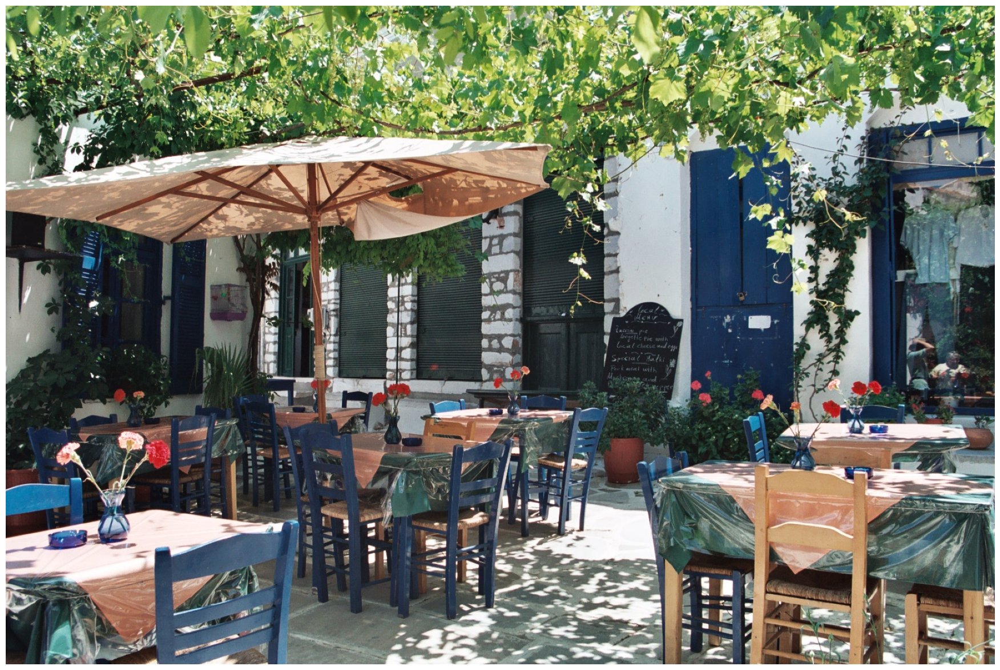

In [16]:
# Get the screen width dynamically for proper display.
fig_width, fig_height = get_screen_width()

# Create a figure and display the external image.
plt.figure(figsize=(fig_width, fig_height))
plt.imshow(external_image)
plt.axis("off")
plt.show()

Process the external image with the Faster R-CNN model and display the results. Note that we will detect objects in the original and the transformed (flipped and grayscale) images.


Processing external image (object detection)...

Detection results keys: dict_keys(['raw_detection_boxes', 'detection_multiclass_scores', 'detection_classes', 'detection_boxes', 'raw_detection_scores', 'num_detections', 'detection_anchor_indices', 'detection_scores'])
Number of detections: 100
Detection results keys: dict_keys(['raw_detection_boxes', 'detection_multiclass_scores', 'detection_classes', 'detection_boxes', 'raw_detection_scores', 'num_detections', 'detection_anchor_indices', 'detection_scores'])
Number of detections: 100
Detection results keys: dict_keys(['raw_detection_boxes', 'detection_multiclass_scores', 'detection_classes', 'detection_boxes', 'raw_detection_scores', 'num_detections', 'detection_anchor_indices', 'detection_scores'])
Number of detections: 100


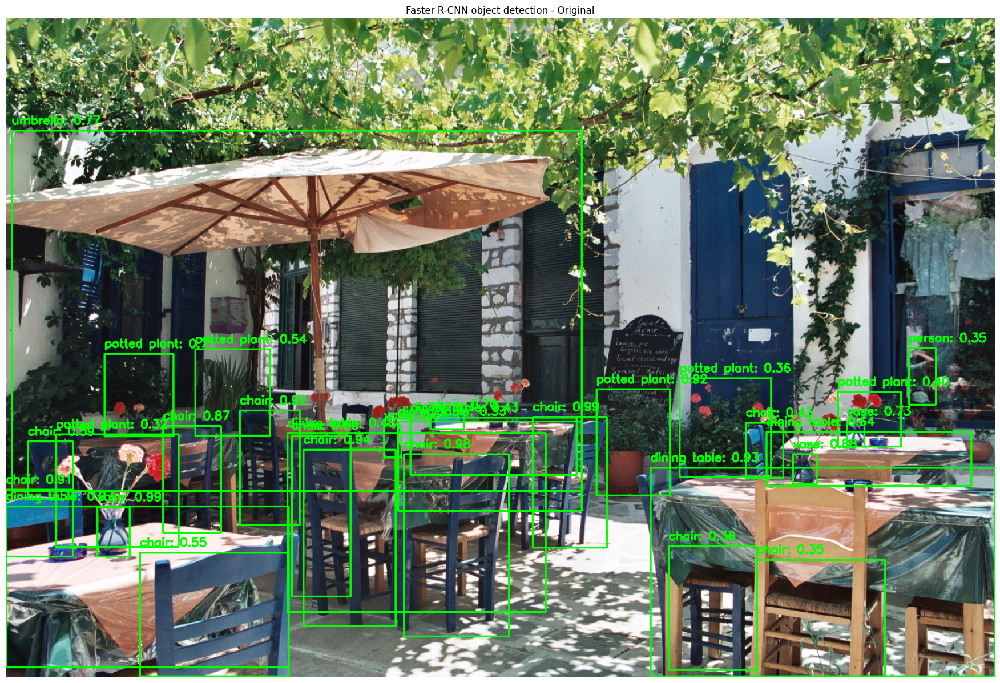

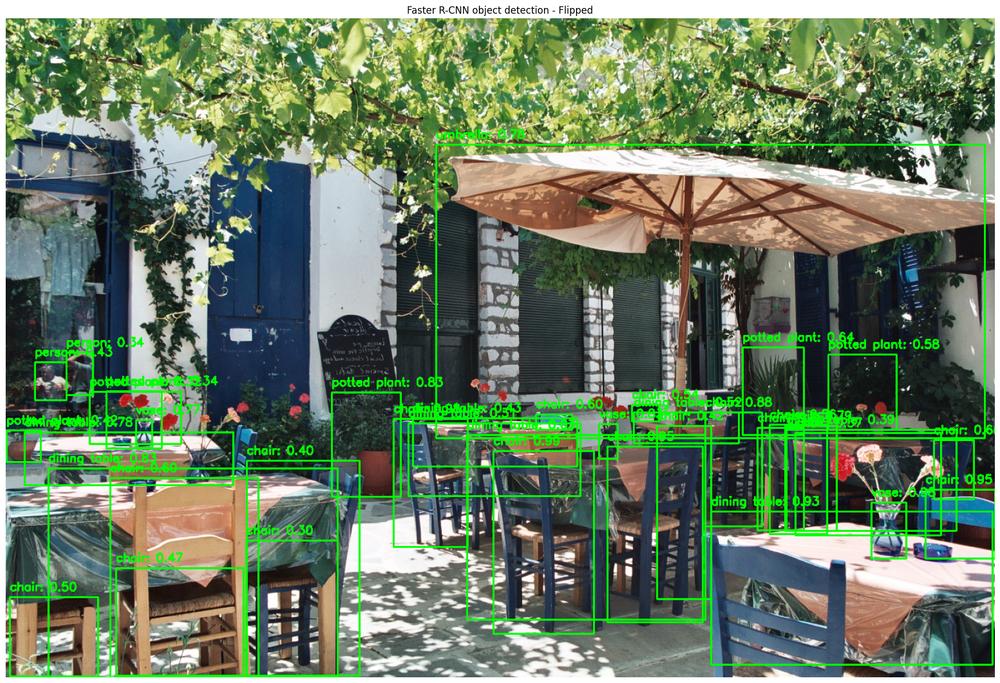

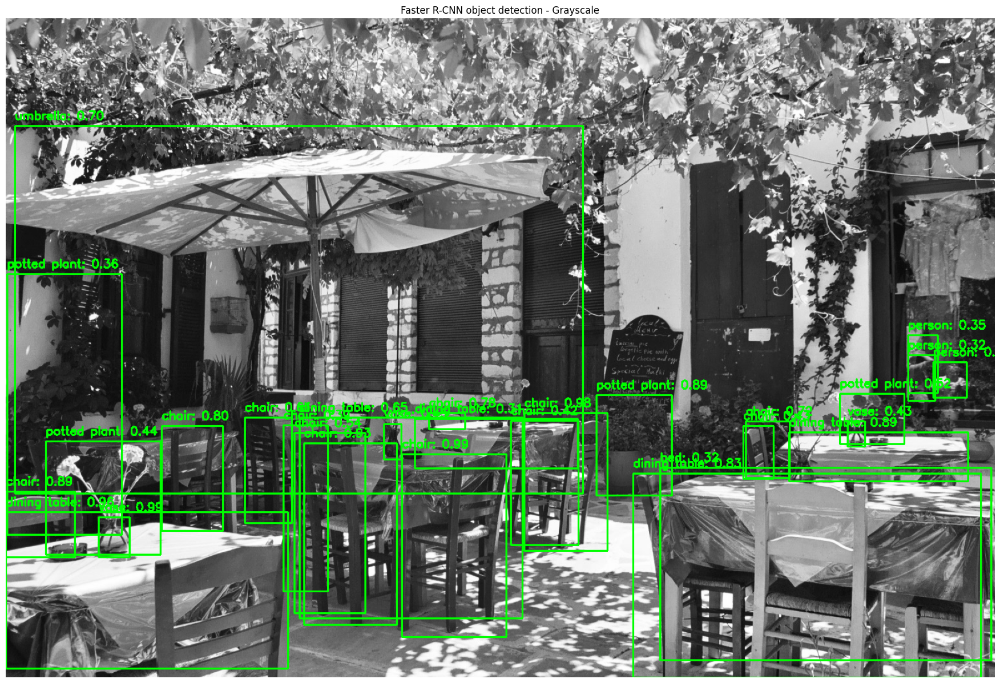

In [17]:
# Process the external image with the Faster R-CNN model and display the results.
print("\nProcessing external image (object detection)...\n")
process_and_show(external_image, faster_rcnn_model, visualize_detections, "Faster R-CNN object detection with transformations")

#### Detection with an uploaded image

To gauge model robustness, use an uploaded image to test the three functionalities: object detection, keypoint detection, and instance segmentation. To that end, use the image `Beach` from TensorFlow’s [object detection tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection). Create a button to upload and display the `Beach` image.

FileUpload(value={}, accept='image/*', description='Upload button')

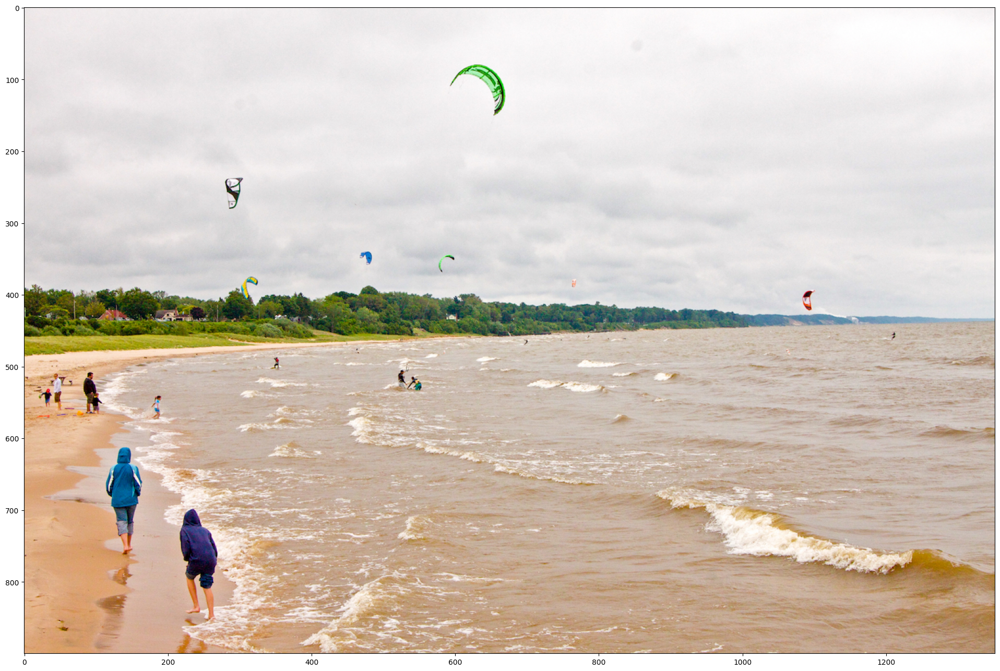

In [18]:
#  Create a button to upload an input image file and display the button.
upload_button = widgets.FileUpload(
    accept="image/*",
    multiple=False,
    description="Upload button"
)

# Display the upload button.
display(upload_button)

# Display the uploaded image once the file is uploaded.
def on_upload(change):
    for filename, file_info in upload_button.value.items():
        image = Image.open(io.BytesIO(file_info["content"]))
        display(image)

# Call function immediately when a file is uploaded.
upload_button.observe(lambda change: on_upload(change), names="value")

Define the function `process_uploaded_image()` to handle uploaded images. The function processes an uploaded image file and runs the selected detection model based on the chosen task type (object detection, keypoint detection, and instance segmentation). It first extracts the uploaded file, converts it into a NumPy array, and ensures that it is in the correct format. Depending on the type of the task, it selects the appropriate model and visualization function. The function then calls `process_and_show()` to apply the selected model and display the results.

**Note:** For object detection, change the value of the field `title` to `Faster R-CNN object detection`. Previously, we used `Faster R-CNN object detection with transformations` and passed that value to `process_and_show()` to apply the detection model to transformed images. However, for an uploaded image, we will skip transformations and focus solely on object detection.

In [42]:
# # Define a function to handle uploaded images and process them with the selected detection model.
def process_uploaded_image(upload_button, task_type):
    if upload_button.value:
        file_info = list(upload_button.value.values())[0]

        # Load the input image correctly from uploaded bytes.
        uploaded_image = Image.open(io.BytesIO(file_info["content"])).convert("RGB")

        # Convert the input image to a NumPy array with the "uint8" data type.
        uploaded_image = np.asarray(uploaded_image, dtype=np.uint8)

        replacement = task_type.replace("_", " ")
        print(f"\nProcessing uploaded image ({replacement})...\n")

        # # Select the appropriate detection model and visualization function based on the task type.
        if task_type == "object_detection":
          model = faster_rcnn_model
          visualization_fn = visualize_detections
          title = "Faster R-CNN object detection"
        elif task_type == "keypoint_detection":
          model = centernet_model
          visualization_fn = visualize_detections
          title = "CenterNet keypoint detection"
        elif task_type == "instance_segmentation":
          model = mask_rcnn_model
          visualization_fn = visualize_instance_segmentation
          title = "Mask R-CNN instance segmentation"
        else:
          print("Invalid task type selected.")
          return

        # Process the uploaded image with the selected detection model and show the results.
        process_and_show(uploaded_image, model, visualization_fn, title)

Next, go ahead and create three upload buttons for validating object detection, keypoint detection, and instance segmentation. Before that, define three callback functions that would be triggered when an image is uploaded for each of these three use cases.

In [20]:
# Callback function triggered when an image is uploaded for object detection.
def on_upload_change_object_detection(change):
    process_uploaded_image(upload_button_1, "object_detection")

In [37]:
# Callback function triggered when an image is uploaded for keypoint detection.
def on_upload_change_keypoints_detection(change):
    process_uploaded_image(upload_button_2, "keypoint_detection")

In [22]:
# Callback function triggered when an image is uploaded for instance segmentation.
def on_upload_change_instance_segmentation(change):
    process_uploaded_image(upload_button_3, "instance_segmentation")

Create a button to upload an input image file for performing object detection and connect it to the object detection functionality. As highlighted, upload the `Beach` image from TensorFlow’s [object detection tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection) for all of the three use cases.

FileUpload(value={}, accept='image/*', description='Upload button 1')


Processing uploaded image (object detection)...

Detection results keys: dict_keys(['raw_detection_boxes', 'detection_multiclass_scores', 'detection_classes', 'detection_boxes', 'raw_detection_scores', 'num_detections', 'detection_anchor_indices', 'detection_scores'])
Number of detections: 100


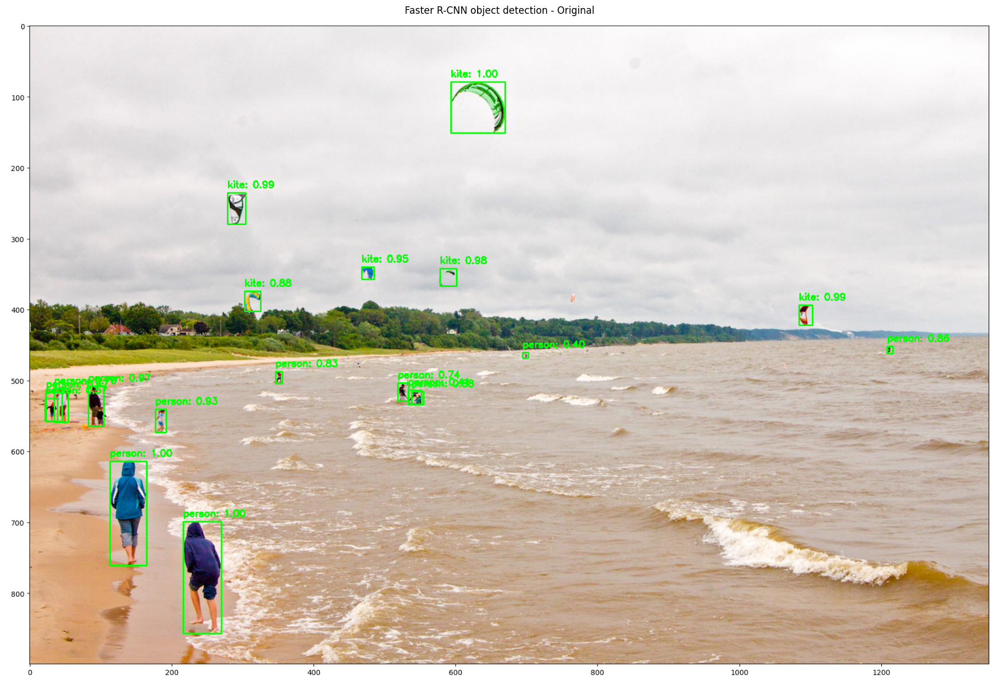

In [43]:
# Create a button to upload an input image file for performing object detection.
upload_button_1 = widgets.FileUpload(
    accept="image/*",
    multiple=False,
    description="Upload button 1"
)

# Display "upload_button_1".
display(upload_button_1)

# Connect "upload_button_1" to the object detection functionality.
upload_button_1.observe(on_upload_change_object_detection, names="value")

Create another button to upload an input image file for performing keypoint detection and connect the button to the keypoint detection functionality. Next, upload the `Beach` image.

FileUpload(value={}, accept='image/*', description='Upload button 2')


Processing uploaded image (keypoint detection)...

Detection results keys: dict_keys(['detection_classes', 'detection_keypoint_scores', 'detection_keypoints', 'num_detections', 'detection_boxes', 'detection_scores'])
Number of detections: 100


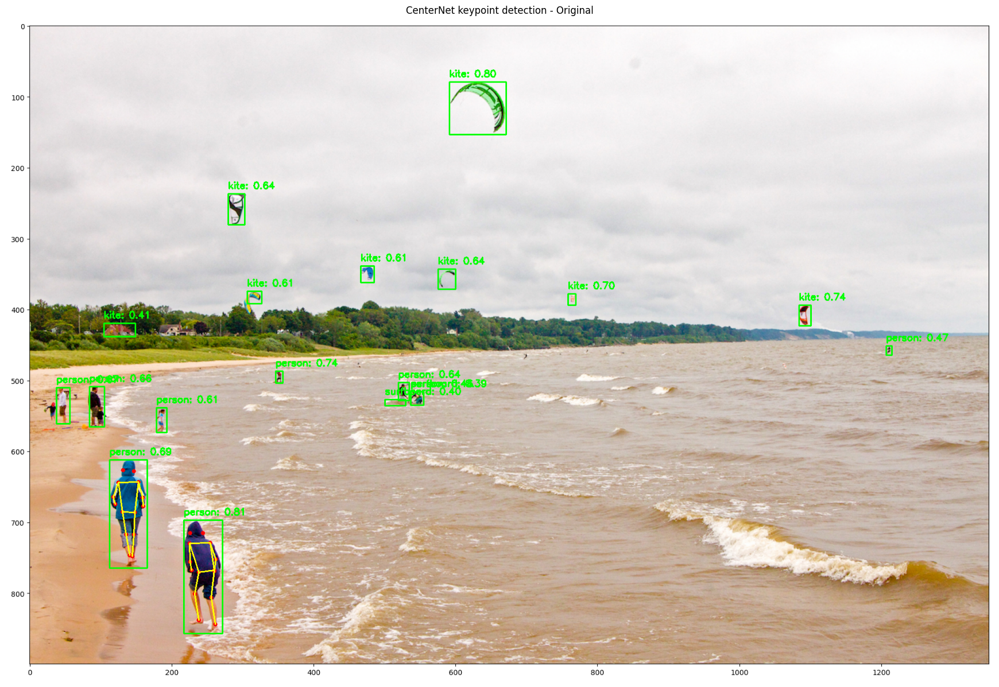

In [44]:
# Create a button to upload an input image file for performing keypoint detection.
upload_button_2 = widgets.FileUpload(
    accept="image/*",
    multiple=False,
    description="Upload button 2"
)

# Display "upload_button_2".
display(upload_button_2)

# Connect "upload_button_2" to the keypoint detection functionality.
upload_button_2.observe(on_upload_change_keypoints_detection, names="value")

Add a third button to upload an image for instance segmentation and link it to the segmentation functionality. Upload the `Beach` image.

FileUpload(value={}, accept='image/*', description='Upload button 3')


Processing uploaded image (instance segmentation)...

Detection results keys: dict_keys(['box_classifier_features', 'proposal_boxes', 'proposal_boxes_normalized', 'detection_classes', 'rpn_box_predictor_features', 'rpn_objectness_predictions_with_background', 'rpn_features_to_crop', 'class_predictions_with_background', 'anchors', 'image_shape', 'num_proposals', 'mask_predictions', 'raw_detection_boxes', 'detection_masks', 'detection_boxes', 'rpn_box_encodings', 'final_anchors', 'detection_multiclass_scores', 'refined_box_encodings', 'raw_detection_scores', 'num_detections', 'detection_anchor_indices', 'detection_scores'])
Masks shape: (100, 33, 33)
Number of detections: 100
Detection 0: class=38, score=1.00, mask_sum=2795, mask_max=1
Detection 1: class=1, score=0.99, mask_sum=7928, mask_max=1
Detection 2: class=1, score=0.99, mask_sum=9553, mask_max=1
Detection 3: class=38, score=0.98, mask_sum=1055, mask_max=1
Detection 4: class=38, score=0.98, mask_sum=360, mask_max=1
Detection 5: c

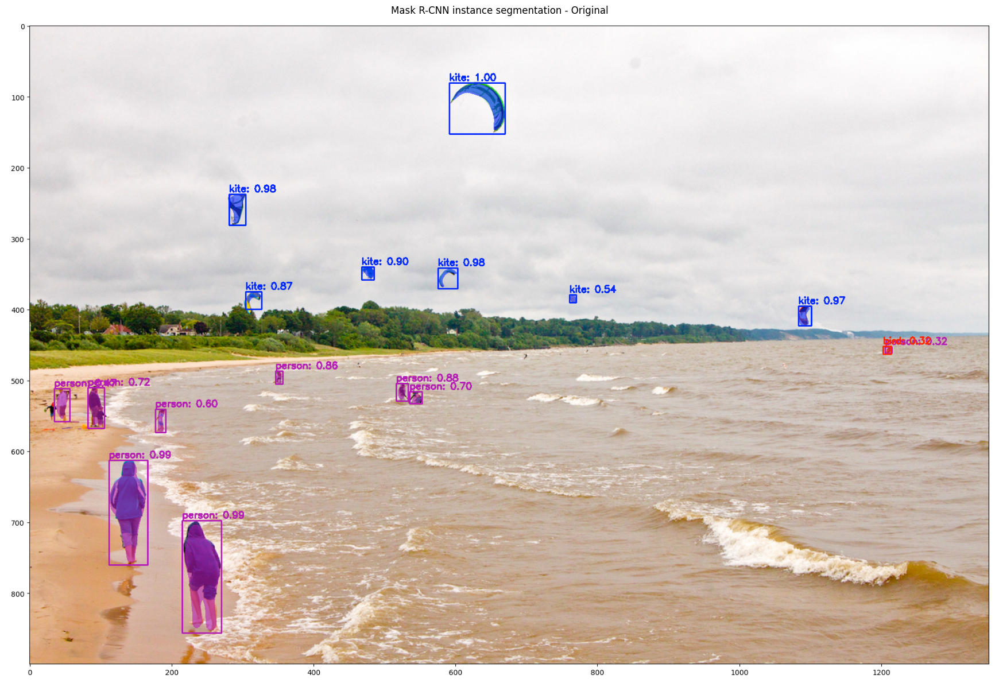

In [45]:
# Create a button to upload an input image file for performing instance segmentation.
upload_button_3 = widgets.FileUpload(
    accept="image/*",
    multiple=False,
    description="Upload button 3"
)

# Display "upload_button_3".
display(upload_button_3)

# Connect "upload_button_3" to the instance segmentation functionality.
upload_button_3.observe(on_upload_change_instance_segmentation, names="value")

## Thoughts

This tutorial covered object detection, keypoint detection, and instance segmentation using models from TensorFlow Hub. It is important to note that this is a quick and dirty implementation of simple detection mechanisms, and the results are not too bad based on the same. The visualizations confirm strong performance across all detection types. Object detection accurately identifies items with high confidence scores (many at 0.95+), even in complex scenes like the cafe patio with multiple overlapping elements. Additionally, the object detection model demonstrated robustness in handling transformations in the image data.

Keypoint detection successfully identifies human poses with well-formed skeletal structures and appropriate joint connections. The instance segmentation effectively applies class-specific color masks with proper transparency, as evident in the clear purple highlighting of people on the beach. The consistent high confidence scores across all three models demonstrate their robustness and reliability, even in challenging environments with varied lighting conditions and partial occlusions. It is amazing how easy it has become to perform complex computer vision (and other ML or deep learning) tasks using fast and efficient libraries and models.

## Next steps

As next steps, consider the following.


1.   **Other Models:** Consider exploring other models for object detection, keypoint detection, and instance detection.The [object detection models](https://www.kaggle.com/models?query=image-object-detection) in TensorFlow Hub, along with TensorFlow's [tutorial](https://www.tensorflow.org/hub/tutorials/tf2_object_detection) tutorial on object detection, serve as a good place to start. Additionally, [here](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/) is another useful TensorFlow tutorial on the TensorFlow Object Detection API.
2.   **Fine-Tuning and Customization:** Instead of using pre-trained detection models as-is, fine-tune them on a custom dataset to improve accuracy for specific use cases. For advanced enhancements, apply techniques like data augmentation to improve detection in low-light, occluded, or complex backgrounds.
3.   **Performance Evaluation:** Check the confidence scores assigned by the detection models, as higher scores indicate greater certainty. Consistently low confidence may suggest poor generalization. Additionally, use labeled datasets with ground-truth annotations to quantitatively assess performance with metrics like mean Average Precision (mAP) and Intersection over Union (IoU).
4.   **Optimization for Deployment:** Optimize models for real-time inference using [LiteRT](https://ai.google.dev/edge/litert), formerly TensorFlow Lite - a suite of tools designed for efficient on-device ML on mobile, embedded, and edge devices. Alternatively, consider [NVIDIA TensorRT](https://developer.nvidia.com/tensorrt) for enhanced performance on edge devices.
5.   **Alternative Architectures:** Experiment with alternative object detection frameworks like [YOLO](https://arxiv.org/abs/1506.02640) or [DETR](https://arxiv.org/abs/2005.12872) to compare their speed and accuracy trade-offs against the detection models used in this tutorial.